<a href="https://colab.research.google.com/github/carakhan15/doing-things/blob/master/Housing_Data_Exploration_(Zillow).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Ingest

In [0]:
import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/noahgift/real_estate_ml/master/Zip_Zhvi_SingleFamilyResidence_2018.csv")

In [0]:
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns; sns.set(color_codes=True)
from sklearn.cluster import KMeans
color = sns.color_palette()
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
%matplotlib inline

/usr/local/lib/python3.6/dist-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [0]:
df.head()

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,...,1037400,1038700,1041500,1042800,1042900,1044400,1047800,1049700,1048300,1047900
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,...,330400,332700,334500,335900,337000,338300,338400,336900,336000,336500
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,...,1317900,1321100,1325300,1323800,1321200,1320700,1319500,1318800,1319700,1323300
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,...,120800,121300,122200,123000,123600,124500,125600,126300,126800,127400
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,...,175500,176400,176900,176900,177300,178000,178500,179300,180200,180700


In [0]:
df.isnull().values.any()

True

In [0]:
df = df.dropna()
df.isnull().values.any()

False

### Clean Up

In [0]:
df.rename(columns={"RegionName":"ZipCode"}, inplace=True)
df["ZipCode"]=df["ZipCode"].map(lambda x: "{:.0f}".format(x))
df["RegionID"]=df["RegionID"].map(lambda x: "{:.0f}".format(x))
df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,...,1037400,1038700,1041500,1042800,1042900,1044400,1047800,1049700,1048300,1047900
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,...,330400,332700,334500,335900,337000,338300,338400,336900,336000,336500
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,...,1317900,1321100,1325300,1323800,1321200,1320700,1319500,1318800,1319700,1323300
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,...,120800,121300,122200,123000,123600,124500,125600,126300,126800,127400
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,...,175500,176400,176900,176900,177300,178000,178500,179300,180200,180700


## EDA

### Describe data

In [0]:
df.describe() #imp

,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
count,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,...,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000
mean,7209.201,119843.979,119964.886,120083.967,120200.023,120327.735,120475.887,120670.394,120896.748,121239.875,...,296637.596,298087.355,299639.037,300985.220,302016.350,303017.074,304232.096,305623.276,306889.113,307909.642
std,4415.323,86787.386,86943.535,87100.133,87261.531,87447.615,87671.976,87955.472,88287.690,88726.163,...,324511.156,325590.838,326899.476,327797.537,327909.039,327991.275,328048.196,327854.154,327338.204,327477.529
min,1.000,11400.000,11500.000,11600.000,11800.000,11800.000,12000.000,12100.000,12200.000,12300.000,...,21700.000,21700.000,22100.000,22600.000,23100.000,23700.000,24300.000,24400.000,24400.000,24600.000
25%,3393.250,70000.000,70100.000,70300.000,70400.000,70600.000,70800.000,71000.000,71200.000,71400.000,...,139100.000,139900.000,140725.000,141625.000,142600.000,143300.000,144225.000,145600.000,146700.000,147400.000
50%,6902.500,100750.000,100800.000,100800.000,101000.000,101000.000,101100.000,101200.000,101300.000,101400.000,...,208200.000,209700.000,211050.000,212700.000,213950.000,214900.000,216250.000,217800.000,219100.000,220000.000
75%,10921.750,144500.000,144600.000,144700.000,144800.000,144900.000,144975.000,145200.000,145500.000,145900.000,...,336300.000,337975.000,339900.000,341100.000,342000.000,342975.000,344275.000,345800.000,347750.000,348975.000
max,15508.000,3676700.000,3704200.000,3729600.000,3754600.000,3781800.000,3813500.000,3849600.000,3888900.000,3928800.000,...,7494200.000,7529400.000,7534400.000,7494600.000,7417200.000,7395700.000,7265400.000,6917500.000,6692700.000,6671700.000


### Median House Prices Exploration

Median House Prices

In [0]:
median_prices = df.median()

print(median_prices.tail())

2018-08   214900.000
2018-09   216250.000
2018-10   217800.000
2018-11   219100.000
2018-12   220000.000
dtype: float64


Check SF Prices compared to median USA

In [0]:
sf_df = df[df["City"] == "San Francisco"].median()
df_comparison = pd.concat([sf_df,median_prices], axis=1)
df_comparison.columns = ["San Francisco","Median USA"]
df_comparison.head()


,San Francisco,Median USA
RegionID,97572.000,77380.500
ZipCode,94118.000,44712.000
SizeRank,1315.000,6902.500
1996-04,306900.000,100750.000
1996-05,307600.000,100800.000


In [0]:
df_comparison.tail()

,San Francisco,Median USA
2018-08,1828600.000,214900.000
2018-09,1823200.000,216250.000
2018-10,1823700.000,217800.000
2018-11,1813400.000,219100.000
2018-12,1806000.000,220000.000


### Visualize EDA

#### Install plotly

In [0]:
!pip uninstall -q -y plotly
!pip install -q plotly
!pip install -q --upgrade cufflinks

    100% |████████████████████████████████| 38.4MB 785kB/s 


In [0]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)
  

#### Use Plotly to plot median house prices

In [0]:
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import cufflinks as cf
cf.go_offline()
df_comparison.iplot(title="Bay Area Median Single Family Home Prices 1996-2018",
                    xTitle="Year",
                    yTitle="Sales Price",
                   #bestfit=True, bestfit_colors=["pink"],
                   #subplots=True,
                   shape=(4,1),
                    #subplot_titles=True,
                    fill=True,)

### Create Clusters

In [0]:
from sklearn.preprocessing import MinMaxScaler

In [0]:
columns_to_drop = ['RegionID', 'ZipCode', 'City', 'State', 'Metro', 'CountyName']
df_numerical = df.dropna()
df_numerical = df_numerical.drop(columns_to_drop, axis=1)

In [0]:
df_numerical.describe()

,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
count,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,...,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000
mean,7209.201,119843.979,119964.886,120083.967,120200.023,120327.735,120475.887,120670.394,120896.748,121239.875,...,296637.596,298087.355,299639.037,300985.220,302016.350,303017.074,304232.096,305623.276,306889.113,307909.642
std,4415.323,86787.386,86943.535,87100.133,87261.531,87447.615,87671.976,87955.472,88287.690,88726.163,...,324511.156,325590.838,326899.476,327797.537,327909.039,327991.275,328048.196,327854.154,327338.204,327477.529
min,1.000,11400.000,11500.000,11600.000,11800.000,11800.000,12000.000,12100.000,12200.000,12300.000,...,21700.000,21700.000,22100.000,22600.000,23100.000,23700.000,24300.000,24400.000,24400.000,24600.000
25%,3393.250,70000.000,70100.000,70300.000,70400.000,70600.000,70800.000,71000.000,71200.000,71400.000,...,139100.000,139900.000,140725.000,141625.000,142600.000,143300.000,144225.000,145600.000,146700.000,147400.000
50%,6902.500,100750.000,100800.000,100800.000,101000.000,101000.000,101100.000,101200.000,101300.000,101400.000,...,208200.000,209700.000,211050.000,212700.000,213950.000,214900.000,216250.000,217800.000,219100.000,220000.000
75%,10921.750,144500.000,144600.000,144700.000,144800.000,144900.000,144975.000,145200.000,145500.000,145900.000,...,336300.000,337975.000,339900.000,341100.000,342000.000,342975.000,344275.000,345800.000,347750.000,348975.000
max,15508.000,3676700.000,3704200.000,3729600.000,3754600.000,3781800.000,3813500.000,3849600.000,3888900.000,3928800.000,...,7494200.000,7529400.000,7534400.000,7494600.000,7417200.000,7395700.000,7265400.000,6917500.000,6692700.000,6671700.000


In [0]:
scaler = MinMaxScaler()
scaled_df = scaler.fit_transform(df_numerical)
kmeans = KMeans(n_clusters=3, random_state=0).fit(scaled_df)
print(len(kmeans.labels_))

/usr/local/lib/python3.6/dist-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


13254


In [0]:
cluster_df = df.copy(deep=True)
cluster_df.dropna(inplace=True)
cluster_df.describe()
cluster_df['cluster'] = kmeans.labels_
cluster_df['appreciation_ratio'] = round(cluster_df["2017-09"]/cluster_df["1996-04"],2)
cluster_df['CityZipCodeAppRatio'] = cluster_df['City'].map(str) + "-" + cluster_df['ZipCode'] + "-" + cluster_df["appreciation_ratio"].map(str)
cluster_df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12,cluster,appreciation_ratio,CityZipCodeAppRatio
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,...,1042800,1042900,1044400,1047800,1049700,1048300,1047900,1,3.020,Chicago-60657-3.02
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,...,335900,337000,338300,338400,336900,336000,336500,0,1.520,Katy-77494-1.52
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,...,1323800,1321200,1320700,1319500,1318800,1319700,1323300,1,2.590,Chicago-60614-2.59
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,...,123000,123600,124500,125600,126300,126800,127400,0,1.550,El Paso-79936-1.55
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,...,176900,177300,178000,178500,179300,180200,180700,0,1.760,Katy-77449-1.76


### Visualize Clusters

In [0]:
import plotly.offline as py
import plotly.graph_objs as go
enable_plotly_in_cell()
trace1 = go.Scatter3d(
    x=cluster_df["appreciation_ratio"],
    y=cluster_df["1996-04"],
    z=cluster_df["2017-09"],
    mode='markers',
    text=cluster_df["CityZipCodeAppRatio"],
    marker=dict(
        size=12,
        color=cluster_df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="30 Year History USA Real Estate Prices (Clusters Colored)",
    scene = dict(
        xaxis = dict(title='X: Appreciation Ratio'),
        yaxis = dict(title="Y:  1996 Prices"),
        zaxis = dict(title="Z:  2017 Prices"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

## Modeling HW:
 
 
* Create a time series forecast
* Find a second model using traditional machine learning (can also find 3rd party data)
* Nice to have (create a sophisticated prediction): https://www.kaggle.com/c/house-prices-advanced-regression-techniques


#### Time Series

In [0]:
df_ts = df.transpose()
df_ts.describe()


,0,1,2,3,4,5,6,7,8,9,...,15494,15496,15498,15499,15500,15502,15503,15504,15505,15507
count,280.000,280.000,280.000,280.000,280.000,280.000,280.000,280.000,280.000,280.000,...,280,280.000,280.000,280.000,280.000,280.000,280.000,280.000,280.000,280
unique,274.000,237.000,276.000,182.000,215.000,220.000,260.000,275.000,272.000,278.000,...,274,202.000,246.000,245.000,250.000,272.000,244.000,235.000,212.000,269
top,735600.000,247900.000,924800.000,77800.000,129400.000,105200.000,247100.000,575300.000,345400.000,2607800.000,...,2108600,69600.000,233200.000,78300.000,116200.000,468200.000,191200.000,87300.000,107700.000,348000
freq,2.000,3.000,3.000,6.000,4.000,4.000,3.000,2.000,3.000,2.000,...,2,6.000,3.000,8.000,6.000,2.000,4.000,5.000,5.000,2


In [0]:
sf_df = df[df["City"] == "San Francisco"]
sf_df.head(20)

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
9,97564,94109,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,10,766000.000,771100.000,776500.000,...,3761200,3810600,3876700,3942300,3982900,3993000,3999000,4014600,4009500,4016600
79,97565,94110,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,80,213900.000,214800.000,216000.000,...,1566500,1592600,1625200,1645500,1651200,1653600,1656100,1654100,1643000,1637100
348,97576,94122,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,349,278400.000,278300.000,278400.000,...,1396800,1405900,1417800,1430000,1441500,1449700,1457300,1463500,1460200,1456700
525,97567,94112,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,526,210100.000,210200.000,210300.000,...,1024500,1030500,1038500,1047300,1055300,1064600,1079100,1096700,1110100,1119700
776,97569,94115,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,777,794000.000,796500.000,799000.000,...,4135600,4149700,4169900,4194500,4222100,4238300,4236100,4241700,4231700,4221300
924,97571,94117,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,925,481000.000,482300.000,483600.000,...,2812700,2844500,2862000,2882100,2908400,2912800,2896900,2892600,2888600,2885600
981,97575,94121,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,982,306900.000,307600.000,308400.000,...,1599400,1620600,1656000,1687200,1706400,1717300,1727700,1735800,1735800,1736200
1132,97572,94118,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,1133,427200.000,429200.000,431400.000,...,2414200,2411400,2442200,2470900,2465400,2450700,2454600,2458700,2441100,2429900
1273,97568,94114,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,1274,394700.000,396000.000,397700.000,...,2382100,2380700,2385700,2402500,2427600,2439700,2432900,2421800,2412800,2410800
1314,97558,94103,San Francisco,CA,San Francisco-Oakland-Hayward,San Francisco County,1315,281000.000,280900.000,280800.000,...,1828500,1835700,1842100,1851300,1856800,1861700,1872200,1881600,1871000,1865300


Text(0.5, 1.0, 'Timeseries of SF Counties')

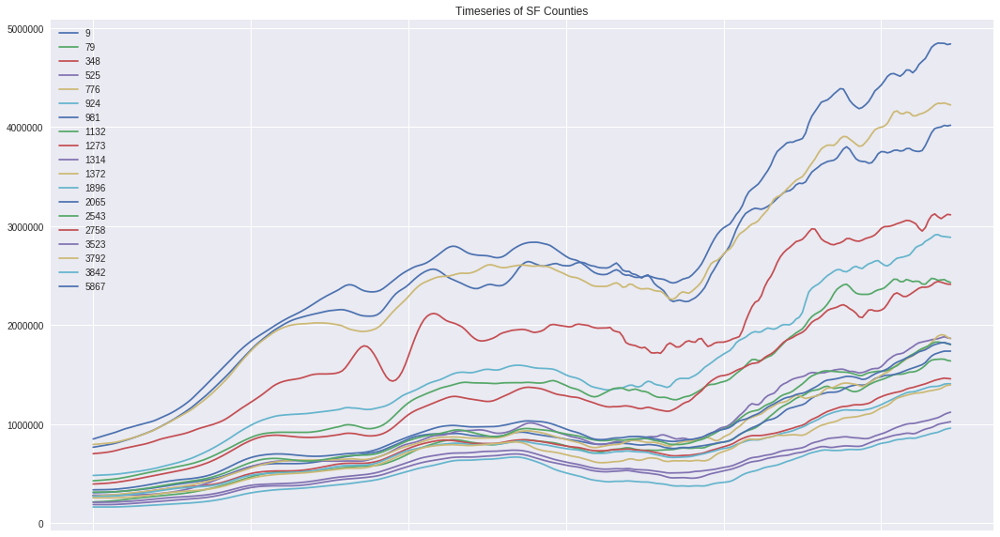

In [0]:
sf_plt=sf_ts[7:].plot(legend=True, figsize=(18,10))
sf_plt.set_title("Timeseries of SF Counties")

We can see that certain counties appreciate faster than others for eg: 
- 94109 - sharp appreciation - Russian Hill/Pork Gulch
- 94123 - sharp appreciation - Marina/Cow Hollow
- 94124 - slower appreciation - Hunter's Point/ Portola Place



#### Model Building

Reference: https://www.kaggle.com/neviadomski/how-to-get-to-top-25-with-simple-model-sklearn


In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
import os;os.listdir("/content/gdrive/My Drive/ML")

['hi.gdoc',
 'kaggle.json',
 'wine.csv',
 'house-prices-advanced-regression-techniques',
 'County_time_series.csv',
 'City_time_series.csv']

In [0]:
!pip install kaggle

In [0]:
!pip install -U -q kaggle
!mkdir -p ~/.kaggle
!cp /content/gdrive/My\ Drive/ML/kaggle.json ~/.kaggle/kaggle.json

In [0]:
!kaggle competitions download -c house-prices-advanced-regression-techniques

  0% 0.00/31.2k [00:00<?, ?B/s]
100% 31.2k/31.2k [00:00<00:00, 27.4MB/s]
  0% 0.00/441k [00:00<?, ?B/s]
100% 441k/441k [00:00<00:00, 60.0MB/s]
  0% 0.00/450k [00:00<?, ?B/s]
100% 450k/450k [00:00<00:00, 62.5MB/s]
  0% 0.00/13.1k [00:00<?, ?B/s]
100% 13.1k/13.1k [00:00<00:00, 13.6MB/s]


In [0]:
train = pd.read_csv("train.csv")
train.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.000,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.000,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.000,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.000,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.000,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [0]:
test = pd.read_csv("test.csv")
test.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.000,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.000,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.000,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.000,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.000,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


In [0]:
## Converting some of the numerical variables which is actually categorical. Except year features since those will be too clutered. 
## the "OverallCond" and "OverallQual" of the house. 
train['OverallCond'] = train['OverallCond'].astype(str) 
train['OverallQual'] = train['OverallQual'].astype(str)

## Important years and months that should be categorical variables not numerical. 
#train['YearBuilt'] = train['YearBuilt'].astype(str)
#train['YearRemodAdd'] = train['YearRemodAdd'].astype(str)
#train['YrSold'] = train['YrSold'].astype(str)
train['MoSold'] = train['MoSold'].astype(str) 
#train['GarageYrBlt'] = train['GarageYrBlt'].astype(str)

## Zoning class are given in numerical; therefore converted to categorical variables. 
train['MSSubClass'] = train['MSSubClass'].astype(str)

/usr/local/lib/python3.6/dist-packages/seaborn/categorical.py:1428: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)


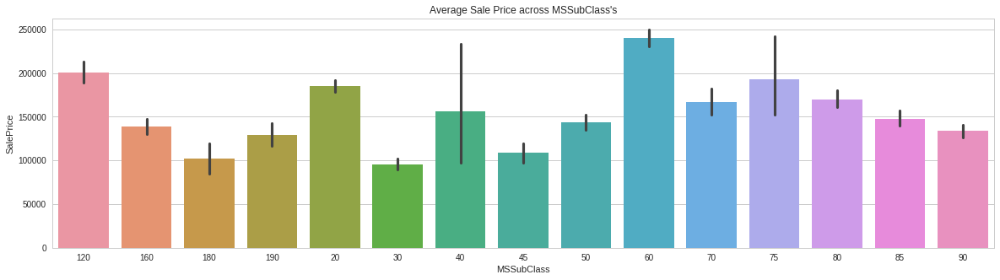

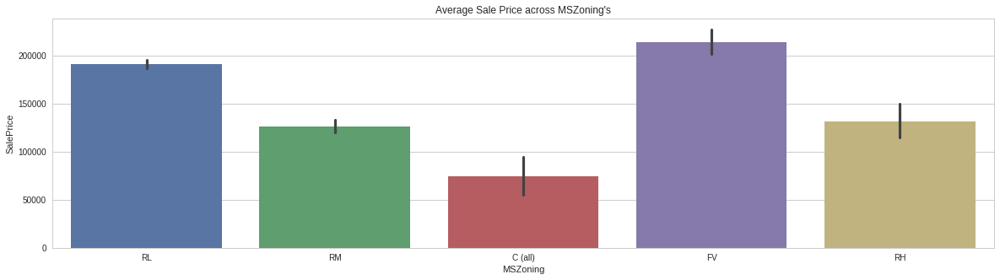

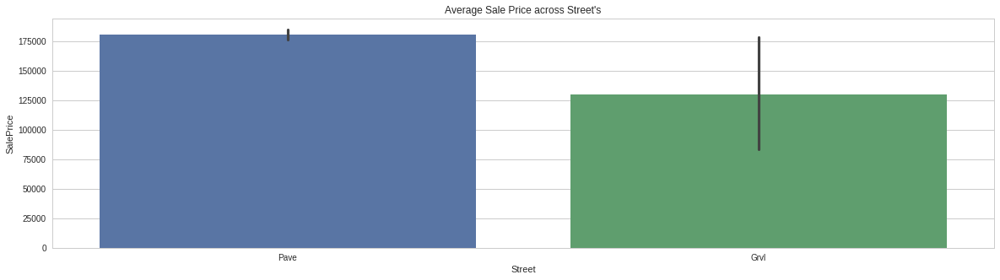

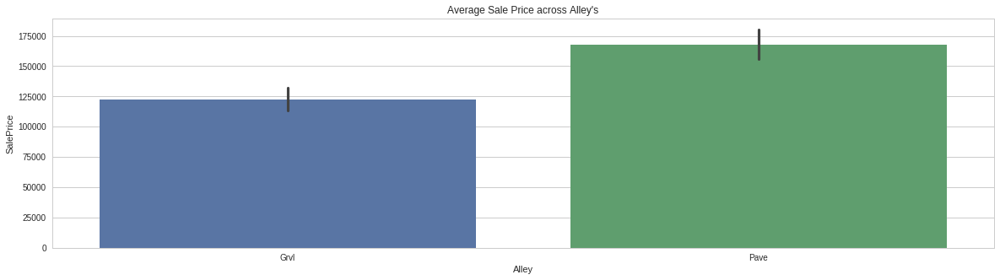

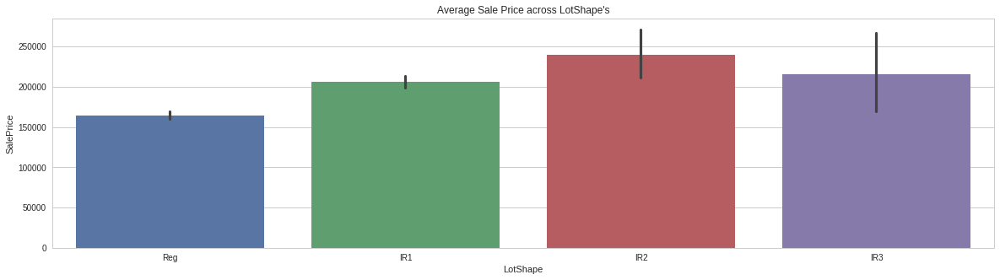

...

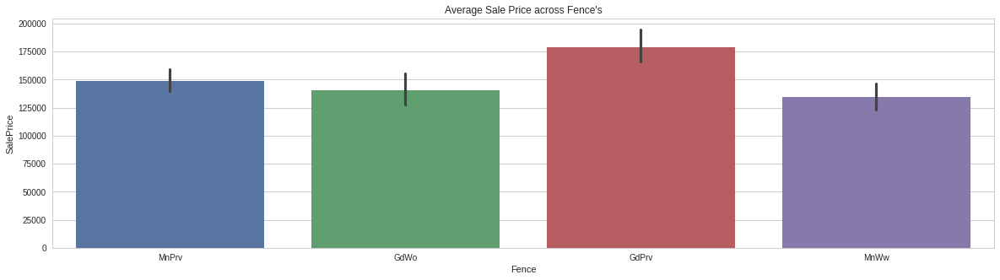

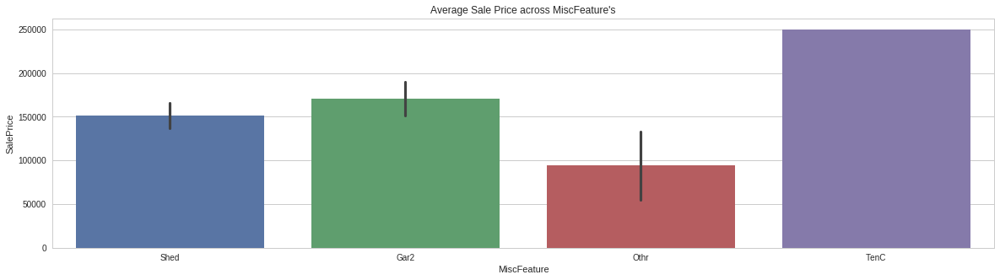

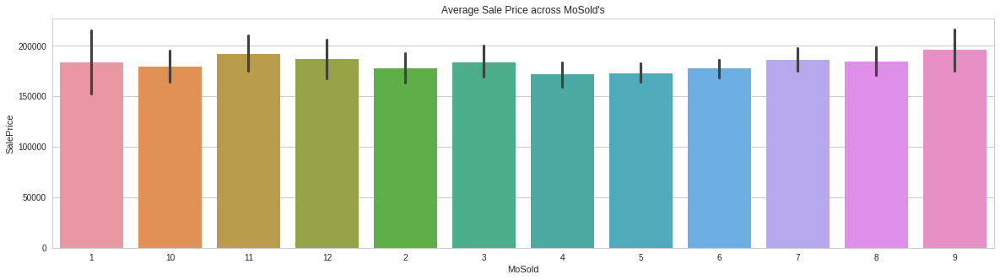

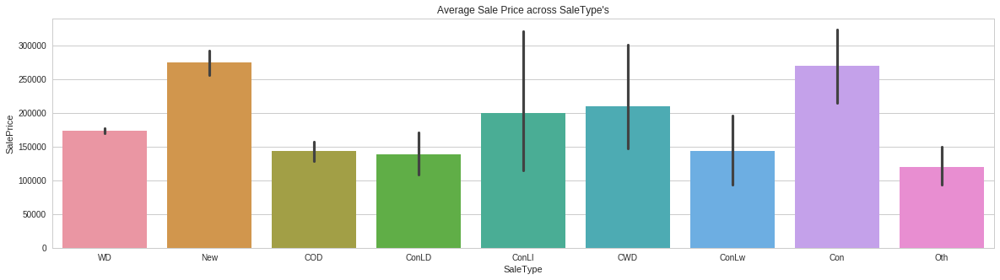

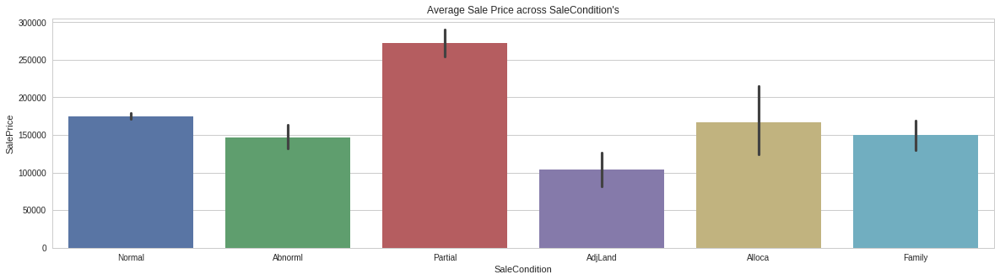

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
# creating barplots for variable with object type and exploring their relation with "SalePrice"
for i in range(len(train.columns)):
    if train[train.columns[i]].dtype == object:
        plt.subplots(figsize = (20,5));
        sns.barplot(y = train["SalePrice"], x = train[train.columns[i]]);
        plt.title("Average Sale Price across {}'s".format((train.columns[i]), y = 1.05, fontsize = 15));
        plt.ylabel("SalePrice");
        plt.xlabel(str(train.columns[i]));
        plt.show();

In [0]:
print ("Total rows and columns in train dataset respectively: " + str(train.shape))
print ("Total rows and columns in test dataset respectively: " + str(test.shape))

Total rows and columns in train dataset respectively: (1460, 81)
Total rows and columns in test dataset respectively: (1459, 80)


#### Describe data

In [0]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
Id,1460.000,730.500,421.610,1.000,365.750,730.500,1095.250,1460.000
LotFrontage,1201.000,70.050,24.285,21.000,59.000,69.000,80.000,313.000
LotArea,1460.000,10516.828,9981.265,1300.000,7553.500,9478.500,11601.500,215245.000
YearBuilt,1460.000,1971.268,30.203,1872.000,1954.000,1973.000,2000.000,2010.000
YearRemodAdd,1460.000,1984.866,20.645,1950.000,1967.000,1994.000,2004.000,2010.000
MasVnrArea,1452.000,103.685,181.066,0.000,0.000,0.000,166.000,1600.000
BsmtFinSF1,1460.000,443.640,456.098,0.000,0.000,383.500,712.250,5644.000
BsmtFinSF2,1460.000,46.549,161.319,0.000,0.000,0.000,0.000,1474.000
BsmtUnfSF,1460.000,567.240,441.867,0.000,223.000,477.500,808.000,2336.000
TotalBsmtSF,1460.000,1057.429,438.705,0.000,795.750,991.500,1298.250,6110.000


In [0]:
train.get_dtype_counts()

float64     3
int64      31
object     47
dtype: int64

#### Split Data

In [0]:
## saving the train and test id for later. 
train_id = train['Id']
test_id = test['Id']

## Dropping the "Id" from train and test set. 
train.drop(columns=['Id'],axis=1, inplace=True)
test.drop(columns=['Id'],axis=1, inplace=True)

In [0]:
## Getting the count of train and test. 
n_train = train.shape[0]
n_test = test.shape[0]

In [0]:
## Saving the target values in "y_train". 
y_train = train.SalePrice.values

In [0]:
## Combining train and test datasets together so that we can do all the work at once. 
all_data = pd.concat((train, test)).reset_index(drop = True)
## Dropping the target variable. 
all_data.drop(['SalePrice'], axis = 1, inplace = True)

In [0]:
## Creating dummy variable 
all_data = pd.get_dummies(all_data, drop_first=True)
all_data.head()

,1stFlrSF,2ndFlrSF,3SsnPorch,BedroomAbvGr,BsmtFinSF1,BsmtFinSF2,BsmtFullBath,BsmtHalfBath,BsmtUnfSF,EnclosedPorch,...,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,Street_Pave,Utilities_NoSeWa
0,856,854,0,3,706.000,0.000,1.000,0.000,150.000,0,...,0,0,0,0,0,0,0,1,1,0
1,1262,0,0,3,978.000,0.000,0.000,1.000,284.000,0,...,0,0,0,0,0,0,0,1,1,0
2,920,866,0,3,486.000,0.000,1.000,0.000,434.000,0,...,0,0,0,0,0,0,0,1,1,0
3,961,756,0,3,216.000,0.000,1.000,0.000,540.000,272,...,0,0,0,0,0,0,0,1,1,0
4,1145,1053,0,4,655.000,0.000,1.000,0.000,490.000,0,...,0,0,0,0,0,0,0,1,1,0


In [0]:
## Once all the pre-processing is complete, we separate train and test dataset. 
train = all_data[:n_train]
test = all_data[n_train:]

In [0]:
## Train test s
from sklearn.model_selection import train_test_split
## Train test split follows this distinguished code pattern and helps creating train and test set to build machine learning. 
train_x, test_x, train_y, test_y = train_test_split(train, y_train,test_size = .33, random_state = 0)

In [0]:
## Plot sizing. 
plt.subplots(figsize = (30,20))
## plotting heatmap.  
sns.heatmap(all_data.corr(), cmap="BrBG", annot=True, center = 0, );
## Set the title. 
plt.title("Heatmap of all the Features", fontsize = 30);

### Compare Prices

In [0]:
county = pd.read_csv("/content/gdrive/My Drive/ML/County_time_series.csv")

In [0]:
df_2 = county.loc[county['RegionName'] == 'san_franciscosan_franciscoca']


,Date,RegionName,DaysOnZillow_AllHomes,InventorySeasonallyAdjusted_AllHomes,InventoryRaw_AllHomes,MedianListingPricePerSqft_1Bedroom,MedianListingPricePerSqft_2Bedroom,MedianListingPricePerSqft_3Bedroom,MedianListingPricePerSqft_4Bedroom,MedianListingPricePerSqft_5BedroomOrMore,...,ZHVI_BottomTier,ZHVI_CondoCoop,ZHVI_MiddleTier,ZHVI_SingleFamilyResidence,ZHVI_TopTier,ZRI_AllHomes,ZRI_AllHomesPlusMultifamily,ZriPerSqft_AllHomes,Zri_MultiFamilyResidenceRental,Zri_SingleFamilyResidenceRental
518786,2017-12-31,9007,nan,1233.000,1128.000,nan,150.265,162.746,152.769,142.396,...,172500.000,142900.000,259700.000,272400.000,381000.000,1620.000,1583.000,1.070,1302.000,1660.000
518787,2017-12-31,9009,nan,4153.000,3710.000,145.474,142.481,155.308,153.252,108.097,...,131700.000,132700.000,220000.000,238800.000,360200.000,1669.000,1593.000,1.154,1294.000,1729.000
518788,2017-12-31,9011,nan,1651.000,1514.000,143.056,137.813,149.932,138.904,102.903,...,157100.000,137700.000,224400.000,231500.000,361100.000,1566.000,1521.000,1.078,1150.000,1591.000
518789,2017-12-31,9013,nan,736.000,655.000,nan,140.014,150.626,136.361,98.394,...,157500.000,118700.000,220000.000,226400.000,327100.000,1709.000,1668.000,1.082,1311.000,1755.000
518790,2017-12-31,9015,nan,538.000,490.000,nan,133.359,138.411,113.813,71.194,...,143200.000,142700.000,191300.000,192700.000,272900.000,1325.000,1316.000,0.922,1124.000,1329.000


In [0]:
dfCity = pd.read_csv("/content/gdrive/My Drive/ML/City_time_series.csv")

In [0]:
df_1 = df_1.dropna()
df_1.isnull().values.any()

False

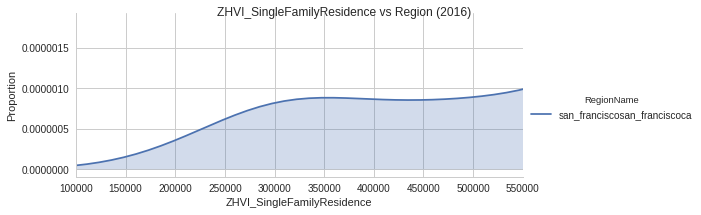

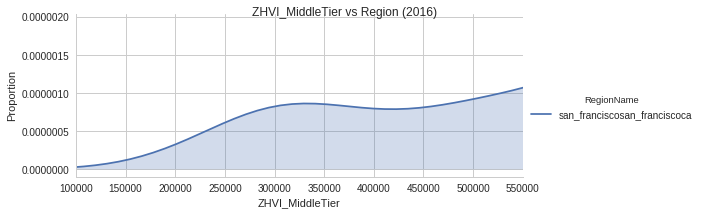

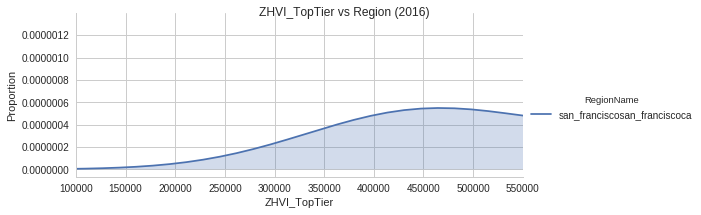

In [0]:
def plotDistribution(data,metric):
    """ Plot distributions """  
    sns.set_style("whitegrid")
    distributionTwo = sns.FacetGrid(data, hue='RegionName',aspect=2.5)
    distributionTwo.map(sns.kdeplot,metric,shade=True)
    distributionTwo.set(xlim=(100000, 550000))
    distributionTwo.add_legend()
    distributionTwo.set_axis_labels(str(metric), 'Proportion')
    distributionTwo.fig.suptitle(str(metric)+' vs Region (2016)')
plotDistribution(df_1, 'ZHVI_SingleFamilyResidence')
plotDistribution(df_1, 'ZHVI_MiddleTier')
plotDistribution(df_1, 'ZHVI_TopTier')

In [0]:
df_1 = dfCity.loc[dfCity['RegionName'] == 'san_franciscosan_franciscoca']
df_1.Date = pd.to_datetime(df_1.Date)
df_1.head()


/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:3643: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


,Date,RegionName,InventorySeasonallyAdjusted_AllHomes,InventoryRaw_AllHomes,MedianListingPricePerSqft_1Bedroom,MedianListingPricePerSqft_2Bedroom,MedianListingPricePerSqft_3Bedroom,MedianListingPricePerSqft_4Bedroom,MedianListingPricePerSqft_5BedroomOrMore,MedianListingPricePerSqft_AllHomes,...,ZHVI_BottomTier,ZHVI_CondoCoop,ZHVI_MiddleTier,ZHVI_SingleFamilyResidence,ZHVI_TopTier,ZRI_AllHomes,ZRI_AllHomesPlusMultifamily,ZriPerSqft_AllHomes,Zri_MultiFamilyResidenceRental,Zri_SingleFamilyResidenceRental
8650,1996-04-30,san_franciscosan_franciscoca,nan,nan,nan,nan,nan,nan,nan,nan,...,191800.000,264600.000,262500.000,261300.000,364900.000,nan,nan,nan,nan,nan
20181,1996-05-31,san_franciscosan_franciscoca,nan,nan,nan,nan,nan,nan,nan,nan,...,192900.000,263700.000,263500.000,263400.000,369600.000,nan,nan,nan,nan,nan
31798,1996-06-30,san_franciscosan_franciscoca,nan,nan,nan,nan,nan,nan,nan,nan,...,193700.000,261700.000,264100.000,265300.000,373600.000,nan,nan,nan,nan,nan
43434,1996-07-31,san_franciscosan_franciscoca,nan,nan,nan,nan,nan,nan,nan,nan,...,193700.000,260900.000,265000.000,266900.000,377200.000,nan,nan,nan,nan,nan
55082,1996-08-31,san_franciscosan_franciscoca,nan,nan,nan,nan,nan,nan,nan,nan,...,193100.000,261800.000,266300.000,268200.000,380300.000,nan,nan,nan,nan,nan


Check Distribution